In [4]:
!pip install torch
!pip install torchvision

     |████████████████████████████████| 1.7 MB 4.4 MB/s eta 0:00:01


In [5]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

import zipfile
import os

# Path to your zip file
zip_path = "/Users/brindaasuri/Desktop/MSBA/OpenAnimalTracks.zip"
# Path where you want to extract the files
extract_path = "/Users/brindaasuri/Desktop/MSBA/OpenAnimalTracks_extracted"

# Create the extraction directory if it doesn't exist
os.makedirs(extract_path, exist_ok=True)

# Extract the files
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Files extracted to {extract_path}")

# Now use the extracted path in your code
data_root = os.path.join(extract_path, "OpenAnimalTracks")
train_dir = os.path.join(data_root, "cropped_imgs/train")
val_dir = os.path.join(data_root, "cropped_imgs/val")
test_dir = os.path.join(data_root, "cropped_imgs/test")

# Create a custom dataset class
class AnimalTracksDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = sorted([d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))])
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        
        self.samples = []
        for class_name in self.classes:
            class_dir = os.path.join(root_dir, class_name)
            for img_name in os.listdir(class_dir):
                if img_name.endswith(('.jpg', '.jpeg', '.png')):
                    self.samples.append((os.path.join(class_dir, img_name), self.class_to_idx[class_name]))
    
    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = AnimalTracksDataset(train_dir, transform=transform)
val_dataset = AnimalTracksDataset(val_dir, transform=transform)
test_dataset = AnimalTracksDataset(test_dir, transform=transform)

# Create dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Print some information about the datasets
print(f"Number of training samples: {len(train_dataset)}")
print(f"Number of validation samples: {len(val_dataset)}")
print(f"Number of test samples: {len(test_dataset)}")
print(f"Number of classes: {len(train_dataset.classes)}")
print(f"Classes: {train_dataset.classes}")

Files extracted to /Users/brindaasuri/Desktop/MSBA/OpenAnimalTracks_extracted
Number of training samples: 2514
Number of validation samples: 346
Number of test samples: 719
Number of classes: 18
Classes: ['beaver', 'black_bear', 'bob_cat', 'coyote', 'elephant', 'goose', 'gray_fox', 'horse', 'lion', 'mink', 'mouse', 'muledeer', 'otter', 'raccoon', 'rat', 'skunk', 'turkey', 'western_grey_squirrel']


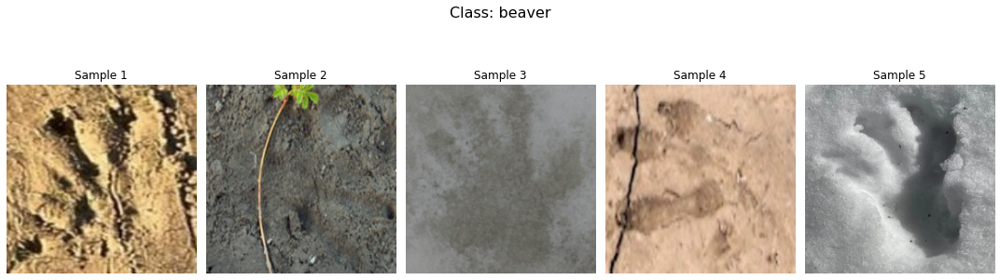

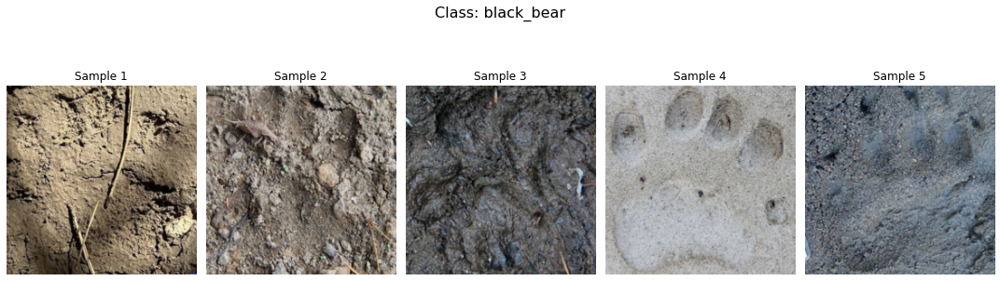

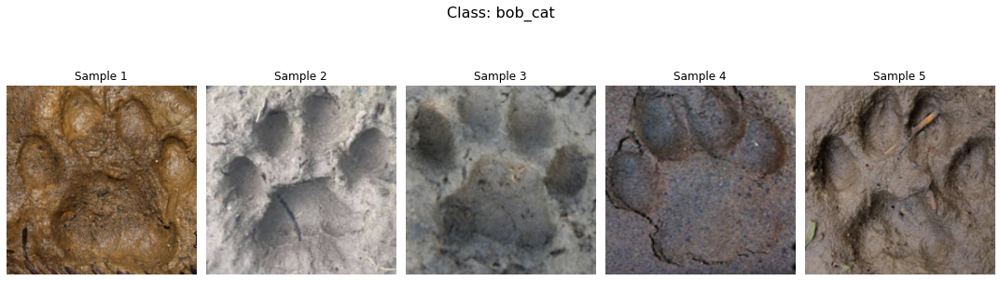

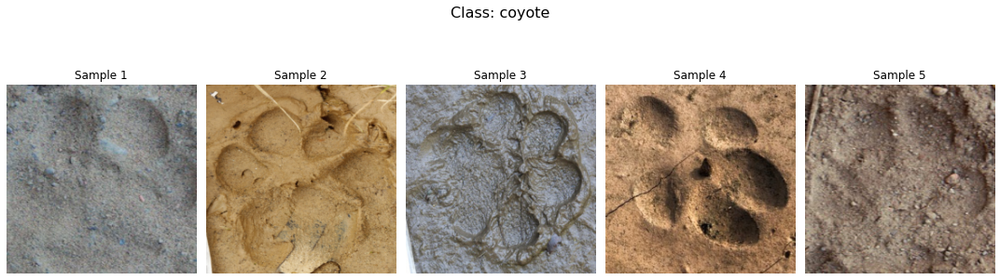

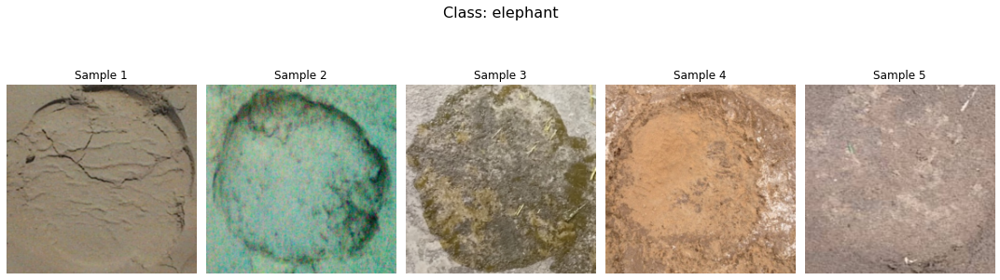

...

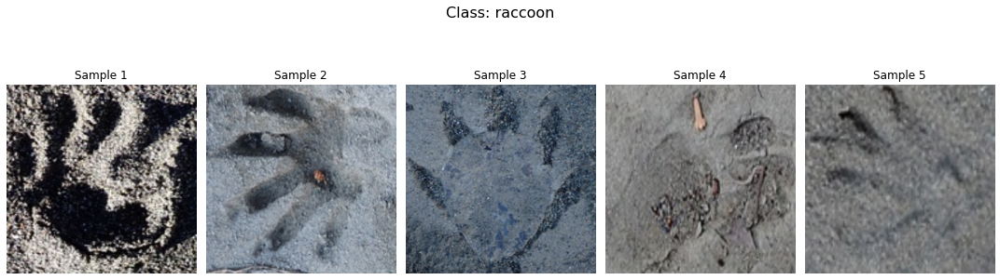

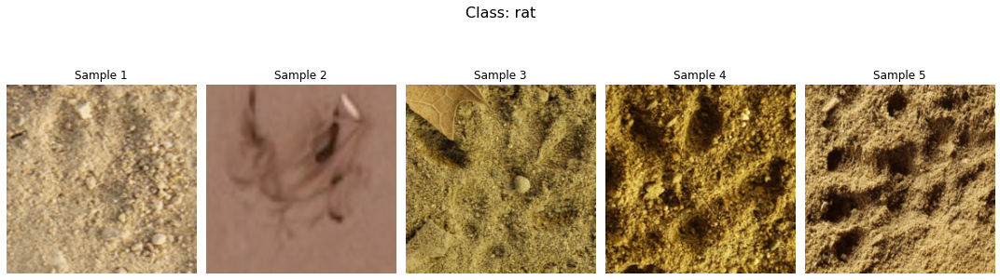

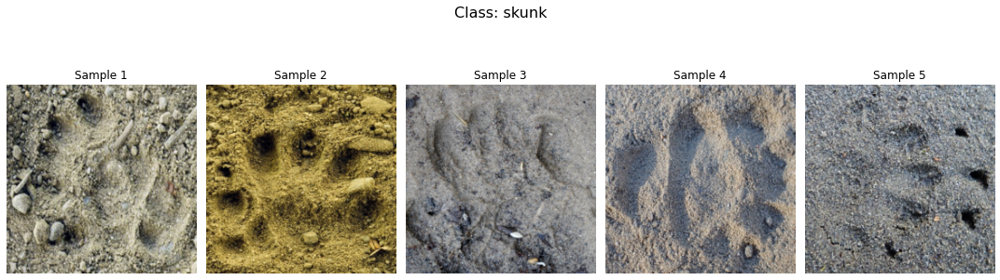

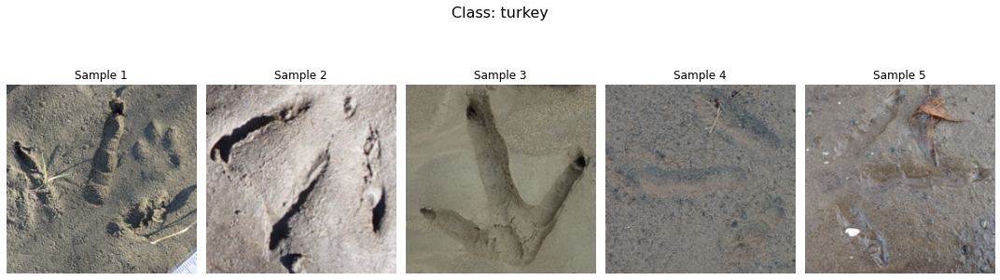

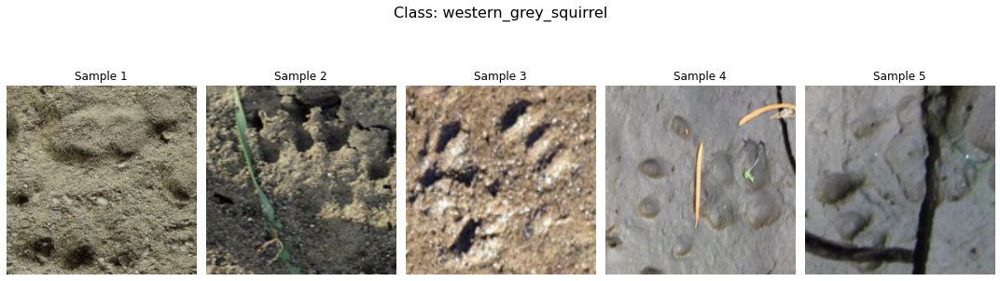

In [7]:
import matplotlib.pyplot as plt
import random
import numpy as np

def display_class_images(dataset, num_images=5):
    """
    Displays a specified number of random images from each class in the dataset.
    """
    # Create a dictionary mapping class index to list of image indices
    class_to_indices = {i: [] for i in range(len(dataset.classes))}
    
    # Populate the dictionary
    for idx, (_, label) in enumerate(dataset.samples):
        class_to_indices[label].append(idx)
    
    # Display images for each class
    for class_idx, class_name in enumerate(dataset.classes):
        # Get indices of images belonging to this class
        indices = class_to_indices[class_idx]
        
        # Select random images (or all if fewer than num_images exist)
        selected_indices = random.sample(indices, min(num_images, len(indices)))
        
        # Create a figure
        fig, axes = plt.subplots(1, len(selected_indices), figsize=(15, 5))
        
        # Display each selected image
        for i, idx in enumerate(selected_indices):
            # Get the image and convert from tensor to numpy array for display
            image, _ = dataset[idx]
            
            # Convert tensor to numpy array and transpose to correct dimensions
            img_np = image.numpy().transpose(1, 2, 0)
            
            # Denormalize the image for display
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            img_np = std * img_np + mean
            
            # Clip values to be between 0 and 1
            img_np = np.clip(img_np, 0, 1)
            
            # Display the image
            if len(selected_indices) > 1:
                axes[i].imshow(img_np)
                axes[i].set_title(f"Sample {i+1}")
                axes[i].axis('off')
            else:
                axes.imshow(img_np)
                axes.set_title(f"Sample {i+1}")
                axes.axis('off')
        
        plt.suptitle(f"Class: {class_name}", fontsize=16)
        plt.tight_layout()
        plt.show()

# Call the function to display images from the training dataset
display_class_images(train_dataset, 5)

Using device: cpu
Number of training samples: 2514
Number of validation samples: 346
Number of test samples: 719
Number of classes: 18
Classes: ['beaver', 'black_bear', 'bob_cat', 'coyote', 'elephant', 'goose', 'gray_fox', 'horse', 'lion', 'mink', 'mouse', 'muledeer', 'otter', 'raccoon', 'rat', 'skunk', 'turkey', 'western_grey_squirrel']
Epoch 1/40
----------


Training: 100%|██████████| 79/79 [04:42<00:00,  3.57s/it]


Training Loss: 2.5933 Acc: 0.1850


Validation: 100%|██████████| 11/11 [00:13<00:00,  1.26s/it]


Validation Loss: 3.2527 Acc: 0.1994
New best model with accuracy: 0.1994

Epoch 2/40
----------


Training: 100%|██████████| 79/79 [04:16<00:00,  3.25s/it]


Training Loss: 2.2568 Acc: 0.2796


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.03s/it]


Validation Loss: 2.2610 Acc: 0.2688
New best model with accuracy: 0.2688

Epoch 3/40
----------


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training Loss: 2.0256 Acc: 0.3492


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 3.0837 Acc: 0.2486

Epoch 4/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 1.8398 Acc: 0.3862


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.00s/it]


Validation Loss: 2.0347 Acc: 0.3555
New best model with accuracy: 0.3555

Epoch 5/40
----------


Training: 100%|██████████| 79/79 [04:12<00:00,  3.20s/it]


Training Loss: 1.5996 Acc: 0.4682


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation Loss: 1.7358 Acc: 0.4942
New best model with accuracy: 0.4942

Epoch 6/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 1.4197 Acc: 0.5330


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.9875 Acc: 0.4306

Epoch 7/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 1.3273 Acc: 0.5748


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.01s/it]


Validation Loss: 1.7679 Acc: 0.4769

Epoch 8/40
----------


Training: 100%|██████████| 79/79 [04:10<00:00,  3.17s/it]


Training Loss: 1.0110 Acc: 0.6778


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.2815 Acc: 0.5838
New best model with accuracy: 0.5838

Epoch 9/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.8250 Acc: 0.7379


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.04it/s]


Validation Loss: 1.2241 Acc: 0.6069
New best model with accuracy: 0.6069

Epoch 10/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.7241 Acc: 0.7729


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation Loss: 1.1932 Acc: 0.6503
New best model with accuracy: 0.6503

Epoch 11/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.6888 Acc: 0.7737


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.2154 Acc: 0.6387

Epoch 12/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.6216 Acc: 0.8039


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.2011 Acc: 0.6243

Epoch 13/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.5574 Acc: 0.8274


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.2287 Acc: 0.6243

Epoch 14/40
----------


Training: 100%|██████████| 79/79 [04:07<00:00,  3.13s/it]


Training Loss: 0.5420 Acc: 0.8309


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.2081 Acc: 0.6329

Epoch 15/40
----------


Training: 100%|██████████| 79/79 [04:11<00:00,  3.18s/it]


Training Loss: 0.4706 Acc: 0.8584


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.03s/it]


Validation Loss: 1.1878 Acc: 0.6445

Epoch 16/40
----------


Training: 100%|██████████| 79/79 [04:07<00:00,  3.13s/it]


Training Loss: 0.4512 Acc: 0.8656


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1830 Acc: 0.6474

Epoch 17/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.4184 Acc: 0.8819


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1623 Acc: 0.6474

Epoch 18/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4471 Acc: 0.8691


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1802 Acc: 0.6503

Epoch 19/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.4249 Acc: 0.8743


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.00it/s]


Validation Loss: 1.1764 Acc: 0.6474

Epoch 20/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.11s/it]


Training Loss: 0.4315 Acc: 0.8787


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.01s/it]


Validation Loss: 1.1718 Acc: 0.6561
New best model with accuracy: 0.6561

Epoch 21/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4149 Acc: 0.8755


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1672 Acc: 0.6387

Epoch 22/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4035 Acc: 0.8866


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.03s/it]


Validation Loss: 1.1717 Acc: 0.6532

Epoch 23/40
----------


Training: 100%|██████████| 79/79 [04:11<00:00,  3.18s/it]


Training Loss: 0.3897 Acc: 0.8914


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1730 Acc: 0.6532

Epoch 24/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.4061 Acc: 0.8846


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1753 Acc: 0.6474

Epoch 25/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3794 Acc: 0.8910


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1610 Acc: 0.6532

Epoch 26/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3990 Acc: 0.8850


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1657 Acc: 0.6445

Epoch 27/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.4049 Acc: 0.8874


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1660 Acc: 0.6618
New best model with accuracy: 0.6618

Epoch 28/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4068 Acc: 0.8807


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1657 Acc: 0.6561

Epoch 29/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.09s/it]


Training Loss: 0.3882 Acc: 0.8926


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1629 Acc: 0.6503

Epoch 30/40
----------


Training: 100%|██████████| 79/79 [04:08<00:00,  3.14s/it]


Training Loss: 0.4087 Acc: 0.8827


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1636 Acc: 0.6387

Epoch 31/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.4019 Acc: 0.8870


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1739 Acc: 0.6561

Epoch 32/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3908 Acc: 0.8902


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1658 Acc: 0.6503

Epoch 33/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3850 Acc: 0.8906


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1860 Acc: 0.6445

Epoch 34/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4031 Acc: 0.8807


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1627 Acc: 0.6618

Epoch 35/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4019 Acc: 0.8866


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation Loss: 1.1613 Acc: 0.6532

Epoch 36/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.3993 Acc: 0.8890


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1564 Acc: 0.6561

Epoch 37/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.3927 Acc: 0.8894


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1724 Acc: 0.6561

Epoch 38/40
----------


Training: 100%|██████████| 79/79 [04:08<00:00,  3.14s/it]


Training Loss: 0.4007 Acc: 0.8815


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1726 Acc: 0.6387

Epoch 39/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3895 Acc: 0.8866


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1703 Acc: 0.6503

Epoch 40/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.11s/it]


Training Loss: 0.3974 Acc: 0.8902


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1677 Acc: 0.6474

Training completed in 172m 26s
Best validation accuracy: 0.6618


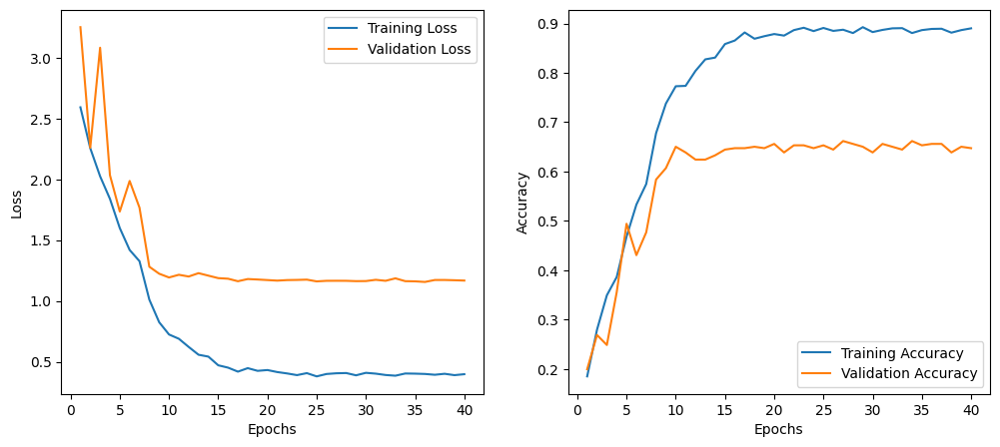

Evaluating: 100%|██████████| 23/23 [00:27<00:00,  1.21s/it]


<Figure size 1000x800 with 0 Axes>

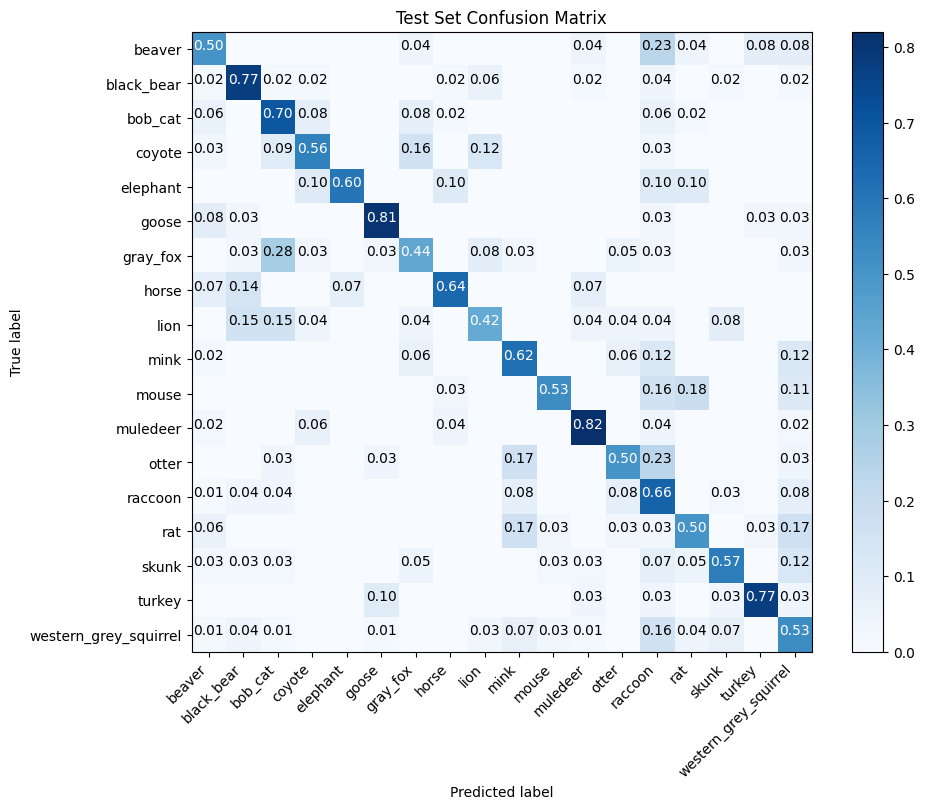


Per-class accuracy:
beaver: 0.5000
black_bear: 0.7736
bob_cat: 0.6981
coyote: 0.5625
elephant: 0.6000
goose: 0.8056
gray_fox: 0.4359
horse: 0.6429
lion: 0.4231
mink: 0.6200
mouse: 0.5263
muledeer: 0.8200
otter: 0.5000
raccoon: 0.6582
rat: 0.5000
skunk: 0.5750
turkey: 0.7742
western_grey_squirrel: 0.5263
Test accuracy: 0.6189
Displaying sample images from the training set:


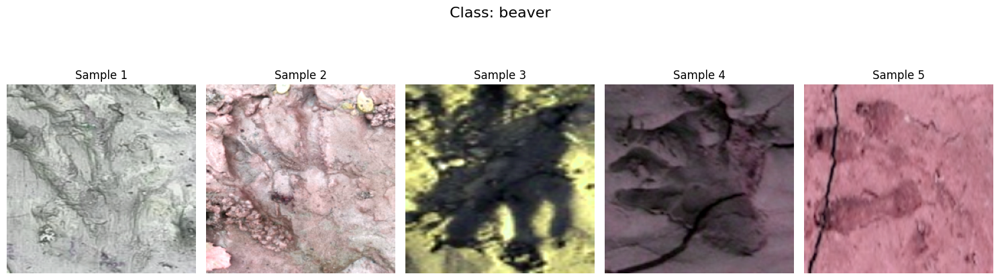

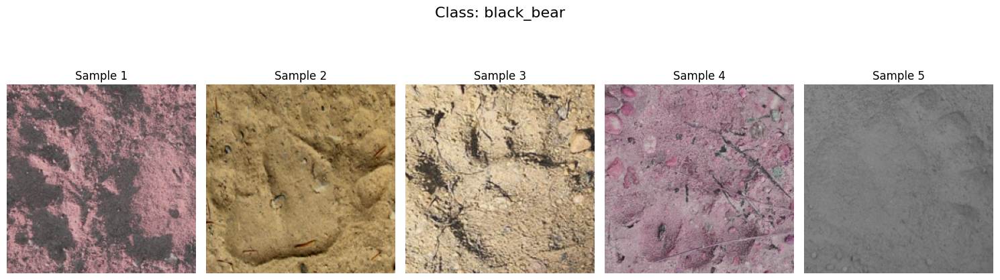

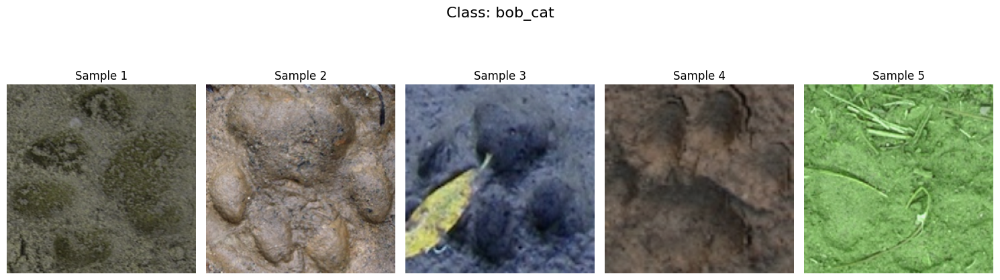

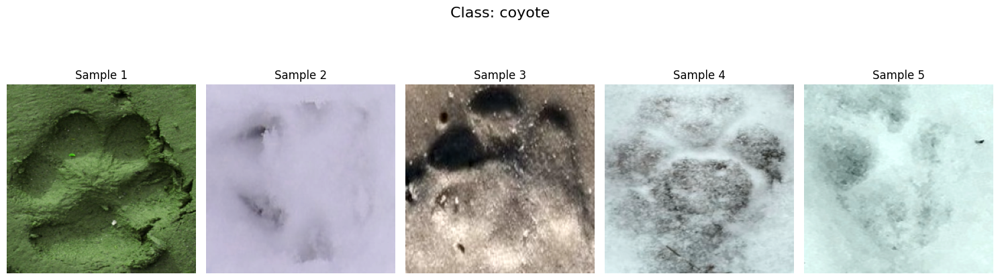

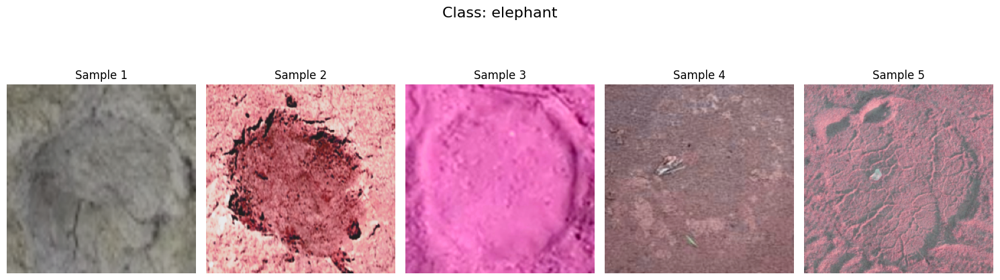

...

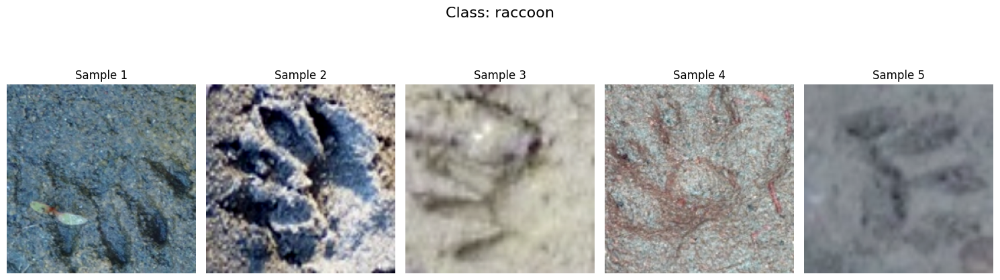

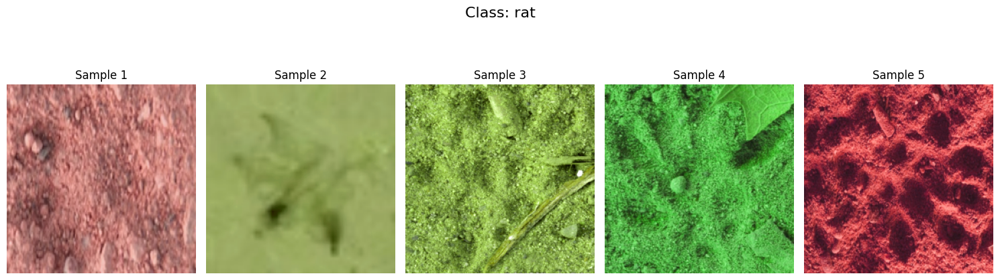

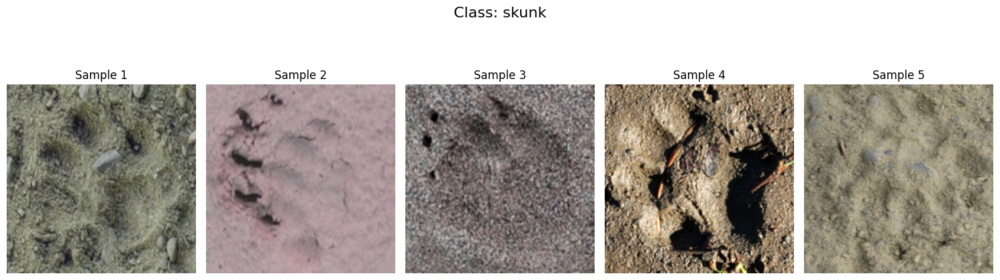

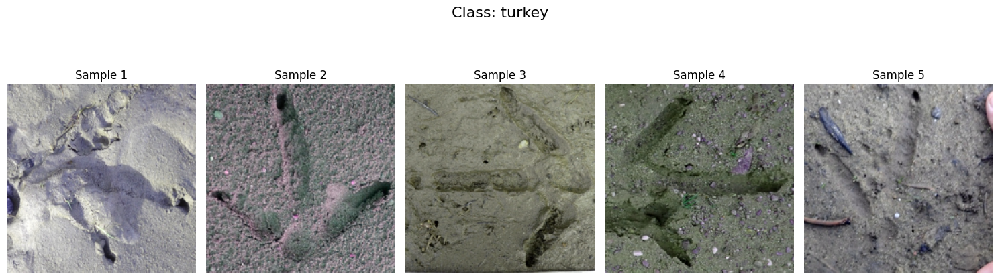

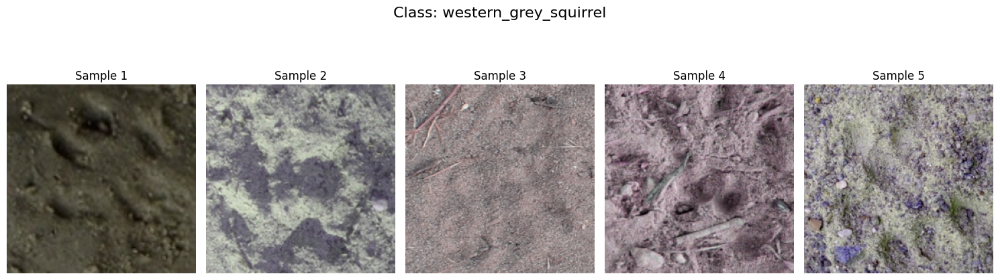

In [5]:
# Main function to run the training
def run_training():
    # Set random seeds for reproducibility
    torch.manual_seed(42)
    random.seed(42)
    np.random.seed(42)
    
    # Define your paths here
    extract_path = "/Users/brindaasuri/Desktop/MSBA/OpenAnimalTracks_extracted"
    data_root = os.path.join(extract_path, "OpenAnimalTracks")
    train_dir = os.path.join(data_root, "cropped_imgs/train")
    val_dir = os.path.join(data_root, "cropped_imgs/val")
    test_dir = os.path.join(data_root, "cropped_imgs/test")
    
    # Device configuration
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Simple transforms without custom transforms that need pickling
    train_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    val_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    # Create datasets
    train_dataset = AnimalTracksDataset(train_dir, transform=train_transform)
    val_dataset = AnimalTracksDataset(val_dir, transform=val_transform)
    test_dataset = AnimalTracksDataset(test_dir, transform=val_transform)
    
    # Create dataloaders with NO workers to avoid pickling
    batch_size = 32
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    
    # Print dataset information
    print(f"Number of training samples: {len(train_dataset)}")
    print(f"Number of validation samples: {len(val_dataset)}")
    print(f"Number of test samples: {len(test_dataset)}")
    print(f"Number of classes: {len(train_dataset.classes)}")
    print(f"Classes: {train_dataset.classes}")
    
    # Create model
    # For ResNet, use a simpler initialization approach
    model = models.resnet18()
    if hasattr(models.ResNet18_Weights, 'IMAGENET1K_V1'):
        # Newer PyTorch versions
        model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
    else:
        # Older PyTorch versions
        model = models.resnet18(pretrained=True)
    
    num_classes = len(train_dataset.classes)
    # Replace the final fully connected layer
    model.fc = nn.Linear(model.fc.in_features, num_classes)
    model = model.to(device)
    
    # Loss function, optimizer, and scheduler
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)
    # Learning rate scheduler
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)
    
    # Train and evaluate the model
    model, best_acc = train_model(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        criterion=criterion,
        optimizer=optimizer,
        scheduler=scheduler,
        num_epochs=40,  # Start with fewer epochs for testing
        device=device
    )
    
    # Save the model
    os.makedirs('models', exist_ok=True)
    torch.save(model.state_dict(), 'models/animal_tracks_model.pth')
    
    # Evaluate on test set
    test_acc, test_cm = evaluate_model(model, test_loader, device, train_dataset.classes)
    print(f'Test accuracy: {test_acc:.4f}')
    
    # Display sample images
    print("Displaying sample images from the training set:")
    display_class_images(train_dataset, 5)

if __name__ == "__main__":
    run_training()

## Transformer Model


In [10]:
!pip install timm

     |████████████████████████████████| 2.4 MB 6.5 MB/s eta 0:00:01
     |████████████████████████████████| 436 kB 8.3 MB/s eta 0:00:01
     |████████████████████████████████| 468 kB 30.9 MB/s eta 0:00:01
     |████████████████████████████████| 194 kB 42.4 MB/s eta 0:00:01
  Attempting uninstall: fsspec
    Found existing installation: fsspec 0.9.0
    Uninstalling fsspec-0.9.0:
      Successfully uninstalled fsspec-0.9.0


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Epoch 1/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 2.6196 Acc: 0.1822


Validation: 100%|██████████| 11/11 [02:48<00:00, 15.33s/it]


Validation Loss: 2.3815 Acc: 0.2225


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.2225

Epoch 2/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 2.0850 Acc: 0.3345


Validation: 100%|██████████| 11/11 [02:12<00:00, 12.03s/it]


Validation Loss: 2.1168 Acc: 0.3555


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.3555

Epoch 3/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 1.4754 Acc: 0.5402


Validation: 100%|██████████| 11/11 [02:08<00:00, 11.69s/it]


Validation Loss: 1.9689 Acc: 0.4220


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.4220

Epoch 4/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.7875 Acc: 0.7530


Validation: 100%|██████████| 11/11 [02:07<00:00, 11.61s/it]


Validation Loss: 1.7903 Acc: 0.4566


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.4566

Epoch 5/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.4029 Acc: 0.8691


Validation: 100%|██████████| 11/11 [02:05<00:00, 11.41s/it]


Validation Loss: 1.9471 Acc: 0.4971


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.4971

Epoch 6/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0960 Acc: 0.9702


Validation: 100%|██████████| 11/11 [02:17<00:00, 12.52s/it]


Validation Loss: 1.8881 Acc: 0.5318


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.5318

Epoch 7/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0156 Acc: 0.9984


Validation: 100%|██████████| 11/11 [02:05<00:00, 11.37s/it]


Validation Loss: 2.0189 Acc: 0.5434


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.5434

Epoch 8/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0064 Acc: 1.0000


Validation: 100%|██████████| 11/11 [02:08<00:00, 11.71s/it]


Validation Loss: 2.1137 Acc: 0.5462


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.5462

Epoch 9/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0039 Acc: 1.0000


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.1942 Acc: 0.5434

Epoch 10/10
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0027 Acc: 1.0000


Validation: 100%|██████████| 11/11 [02:26<00:00, 13.32s/it]


Validation Loss: 2.2510 Acc: 0.5462

Training completed in 697m 56s
Best validation accuracy: 0.5462


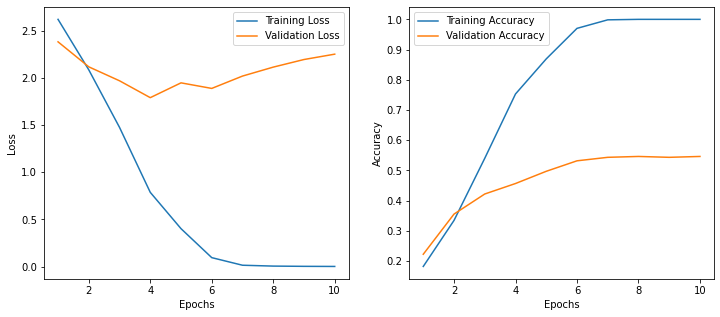

Evaluating: 100%|██████████| 23/23 [04:33<00:00, 11.88s/it]


<Figure size 720x576 with 0 Axes>

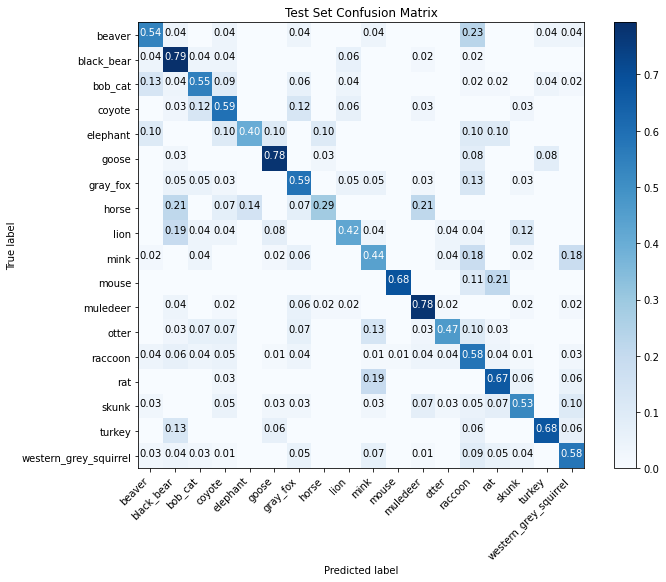


Per-class accuracy:
beaver: 0.5385
black_bear: 0.7925
bob_cat: 0.5472
coyote: 0.5938
elephant: 0.4000
goose: 0.7778
gray_fox: 0.5897
horse: 0.2857
lion: 0.4231
mink: 0.4400
mouse: 0.6842
muledeer: 0.7800
otter: 0.4667
raccoon: 0.5823
rat: 0.6667
skunk: 0.5250
turkey: 0.6774
western_grey_squirrel: 0.5789
Test Accuracy: 0.5994


In [11]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms
import timm
import time
import copy
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.metrics import confusion_matrix
import numpy as np
import itertools


transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

#create datasets
train_dataset = AnimalTracksDataset(train_dir, transform=transform)
val_dataset = AnimalTracksDataset(val_dir, transform=transform)
test_dataset = AnimalTracksDataset(test_dir, transform=transform)

#create dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


#create a Vision Transformer (ViT) using timm

num_classes = len(train_dataset.classes)
#create the ViT model (here we use vit_base_patch16_224)
model = timm.create_model('vit_base_patch16_224', pretrained=True)
#replace the head to output predictions for your dataset
model.head = nn.Linear(model.head.in_features, num_classes)

#move model to device (GPU if available)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

#define Loss, Optimizer, and Scheduler
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

#training Function (as defined earlier)
def train_model(model, train_loader, val_loader, criterion, optimizer, 
                scheduler, num_epochs, device):
    since = time.time()
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []
    
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        #training phase
        model.train()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0
        
        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            _, preds = torch.max(outputs, 1)
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)
        
        if scheduler:
            scheduler.step()
            
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        train_losses.append(epoch_loss)
        train_accs.append(epoch_acc.item())
        print(f'Training Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        #validation phase
        model.eval()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0
        all_preds = []
        all_labels = []
        
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validation"):
                inputs = inputs.to(device)
                labels = labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                _, preds = torch.max(outputs, 1)
                
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)
                
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())
        
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        val_losses.append(epoch_loss)
        val_accs.append(epoch_acc.item())
        print(f'Validation Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            print(f'New best model with accuracy: {best_acc:.4f}')
        print()
    
    time_elapsed = time.time() - since
    print(f'Training completed in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:.4f}')
    
    model.load_state_dict(best_model_wts)
    
    #plot training curves
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(1, num_epochs+1), train_losses, label='Training Loss')
    plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epochs+1), train_accs, label='Training Accuracy')
    plt.plot(range(1, num_epochs+1), val_accs, label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.show()
    
    return model, best_acc

#evaluation function (as defined earlier)
def evaluate_model(model, data_loader, device, class_names=None):
    model.eval()
    running_corrects = 0
    total_samples = 0
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in tqdm(data_loader, desc="Evaluating"):
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    accuracy = running_corrects.double() / total_samples
    confusion_mat = confusion_matrix(all_labels, all_preds)
    
    if class_names:
        plt.figure(figsize=(10, 8))
        plot_confusion_matrix(confusion_mat, class_names)
        plt.title('Test Set Confusion Matrix')
        plt.show()
        
        print("\nPer-class accuracy:")
        for i, class_name in enumerate(class_names):
            class_total = np.sum(np.array(all_labels) == i)
            if class_total > 0:
                class_correct = confusion_mat[i, i]
                class_acc = class_correct / class_total
                print(f"{class_name}: {class_acc:.4f}")
    
    return accuracy.item(), confusion_mat

# Train the Vision Transformer Model
num_epochs = 8
model, best_val_acc = train_model(model, train_loader, val_loader, 
                                  criterion, optimizer, scheduler, 
                                  num_epochs, device)
# Evaluate the Model on the Test Set
test_accuracy, test_confusion_mat = evaluate_model(model, test_loader, device, class_names=train_dataset.classes)
print(f"Test Accuracy: {test_accuracy:.4f}")


## Freeze/Unfreeze transformer layers

In [13]:
import torch
import torch.nn as nn
import torch.optim as optim
import timm
import time
import copy
from tqdm import tqdm

# --- Progressive Unfreezing Functions ---
def freeze_all_layers(model):
    for param in model.parameters():
        param.requires_grad = False

def unfreeze_head(model):
    for param in model.head.parameters():
        param.requires_grad = True

def unfreeze_last_n_blocks(model, n):
    for block in model.blocks[-n:]:
        for param in block.parameters():
            param.requires_grad = True

# --- Integrated Training Loop ---
def train_model_with_unfreezing(model, train_loader, val_loader, criterion, optimizer, 
                                scheduler, num_epochs, device, unfreeze_epoch=5):
    since = time.time()
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    train_losses, val_losses = [], []
    train_accs, val_accs = [], []
    
    #initial progressive freezing: Freeze everything, then unfreeze head and last 2 blocks.
    freeze_all_layers(model)
    unfreeze_head(model)
    unfreeze_last_n_blocks(model, n=2)
    
    #optimizer set to update only trainable parameters.
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
    
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        #progressive unfreezing: After a given epoch, unfreeze one additional block.
        if epoch == unfreeze_epoch:
            print("Progressive unfreezing: Unfreezing one more block...")
            unfreeze_last_n_blocks(model, n=3)  # Now unfreeze the last 3 blocks
            # Reinitialize optimizer so it includes the newly unfrozen parameters.
            optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
        
        #training phase
        model.train()
        running_loss, running_corrects, total_samples = 0.0, 0, 0
        
        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            _, preds = torch.max(outputs, 1)
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)
        
        if scheduler:
            scheduler.step()
        
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        train_losses.append(epoch_loss)
        train_accs.append(epoch_acc.item())
        print(f'Training Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        #validation phase
        model.eval()
        running_loss, running_corrects, total_samples = 0.0, 0, 0
        
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validation"):
                inputs = inputs.to(device)
                labels = labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                
                _, preds = torch.max(outputs, 1)
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)
        
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        val_losses.append(epoch_loss)
        val_accs.append(epoch_acc.item())
        print(f'Validation Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        #save the best model weights
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            print(f'New best model with accuracy: {best_acc:.4f}')
        print()
    
    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:.4f}')
    
    model.load_state_dict(best_model_wts)
    return model, best_acc, train_losses, train_accs, val_losses, val_accs

# --- Training with Progressive Unfreezing ---
#use timm to c reate the ViT model 
num_classes = 18  # replace with your number of classes, e.g., len(train_dataset.classes)
model = timm.create_model('vit_base_patch16_224', pretrained=True)
model.head = nn.Linear(model.head.in_features, num_classes)

#device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

#define loss, optimizer, and scheduler
criterion = nn.CrossEntropyLoss()
#initially set up optimizer (will be reinitialized in the training loop)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=1e-4)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

#assume train_loader and val_loader are defined already
num_epochs = 20
model, best_acc, train_losses, train_accs, val_losses, val_accs = train_model_with_unfreezing(
    model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs, device, unfreeze_epoch=5
)


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Epoch 1/20
----------


Training: 100%|██████████| 79/79 [30:34<00:00, 23.22s/it]
/Users/brindaasuri/opt/anaconda3/lib/python3.8/site-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "
Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 1.9433 Acc: 0.3938


Validation: 100%|██████████| 11/11 [02:35<00:00, 14.10s/it]


Validation Loss: 1.5436 Acc: 0.5260


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.5260

Epoch 2/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.7703 Acc: 0.7574


Validation: 100%|██████████| 11/11 [02:09<00:00, 11.74s/it]


Validation Loss: 1.4818 Acc: 0.5809


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.5809

Epoch 3/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.2413 Acc: 0.9276


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 1.8849 Acc: 0.5694

Epoch 4/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0995 Acc: 0.9690


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 1.8635 Acc: 0.5549

Epoch 5/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0457 Acc: 0.9837


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 1.9409 Acc: 0.5751

Epoch 6/20
----------
Progressive unfreezing: Unfreezing one more block...


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.1150 Acc: 0.9634


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.2785 Acc: 0.5318

Epoch 7/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0965 Acc: 0.9710


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.3940 Acc: 0.5376

Epoch 8/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0552 Acc: 0.9853


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.5472 Acc: 0.5578

Epoch 9/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0161 Acc: 0.9948


Validation: 100%|██████████| 11/11 [26:58<00:00, 147.17s/it]


Validation Loss: 2.2728 Acc: 0.5867


Training:   0%|          | 0/79 [00:00<?, ?it/s]

New best model with accuracy: 0.5867

Epoch 10/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0307 Acc: 0.9912


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.3103 Acc: 0.5838

Epoch 11/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0193 Acc: 0.9952


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.5039 Acc: 0.5780

Epoch 12/20
----------


Training: 100%|██████████| 79/79 [56:25<00:00, 42.86s/it]  


Training Loss: 0.0486 Acc: 0.9849


Validation: 100%|██████████| 11/11 [06:17<00:00, 34.32s/it]


Validation Loss: 2.4274 Acc: 0.5520

Epoch 13/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0445 Acc: 0.9885


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.6587 Acc: 0.5318

Epoch 14/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0901 Acc: 0.9741


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.9973 Acc: 0.5173

Epoch 15/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0775 Acc: 0.9809


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.7837 Acc: 0.5289

Epoch 16/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0543 Acc: 0.9825


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.9233 Acc: 0.5491

Epoch 17/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0767 Acc: 0.9749


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 3.0553 Acc: 0.5578

Epoch 18/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0609 Acc: 0.9833


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.7516 Acc: 0.5723

Epoch 19/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0314 Acc: 0.9924


Training:   0%|          | 0/79 [00:00<?, ?it/s]

Validation Loss: 2.8617 Acc: 0.5809

Epoch 20/20
----------


Validation:   0%|          | 0/11 [00:00<?, ?it/s]

Training Loss: 0.0222 Acc: 0.9940


Validation: 100%|██████████| 11/11 [02:57<00:00, 16.18s/it]


Validation Loss: 2.4508 Acc: 0.6185
New best model with accuracy: 0.6185

Training complete in 726m 27s
Best validation accuracy: 0.6185
